## Project: 
Imagine that you work for a company that develops mobile games. A manager has come to you with a series of tasks to research several aspects of a mobile application:

## Task 1
Retention is one of the most important metrics in the company. Your task is to write a function that calculates player retention. The data is located in the shared folder and has the following structure:

- shared/problem1-reg_data.csv(registration time data)
- shared/problem1-auth_data.csv(user login time data)

In [35]:
import pandas as pd
from datetime import datetime
import numpy as np

In [2]:
registration_df = pd.read_csv('/mnt/HC_Volume_18315164/home-jupyter/jupyter-a-iakhina/shared/problem1-reg_data.csv', encoding = 'windows-1251', sep=';')

In [3]:
registration_df.head()

,reg_ts,uid
0,911382223,1
1,932683089,2
2,947802447,3
3,959523541,4
4,969103313,5


In [4]:
registration_df.shape

(1000000, 2)

In [6]:
registration_df.isna().sum()
#checking for missing values

reg_ts    0
uid       0
dtype: int64

In [7]:
engagement_df = pd.read_csv('/mnt/HC_Volume_18315164/home-jupyter/jupyter-a-iakhina/shared/problem1-auth_data.csv', encoding = 'windows-1251', sep=';')

In [8]:
engagement_df.head()

,auth_ts,uid
0,911382223,1
1,932683089,2
2,932921206,2
3,933393015,2
4,933875379,2


In [9]:
engagement_df.shape

(9601013, 2)

In [10]:
engagement_df.isna().sum()
#checking for missing values

auth_ts    0
uid        0
dtype: int64

In [11]:
df=registration_df.merge(engagement_df, on = 'uid', how='outer')
# combining data frames into one for calculating the retention rate (in one DataFrame, we collect the registration date, authorization date, and the number of users).

In [12]:
df.shape

(9601013, 3)

In [13]:
df.dtypes

reg_ts     int64
uid        int64
auth_ts    int64
dtype: object

In [14]:
df.isna().sum()
#checking for missing values

reg_ts     0
uid        0
auth_ts    0
dtype: int64

In [15]:
df.head()

,reg_ts,uid,auth_ts
0,911382223,1,911382223
1,932683089,2,932683089
2,932683089,2,932921206
3,932683089,2,933393015
4,932683089,2,933875379


In [16]:
#Convert reg_ts and auth_ts to the %Y-%m-%d format
#Find the difference in days between the registration date and the authorization dates to calculate how many days after registration users return to the application
#Create a DataFrame where the cohort is calculated for each day and the number of returning users is counted
#Create a cohort table and calculate the retention rate

In [17]:
def cohort_analysis (df, reg_ts, auth_ts, period='D'):
    
    df['reg_ts'] = pd.to_datetime(df['reg_ts'], unit='s').dt.strftime('%Y-%m-%d')
    df['auth_ts'] = pd.to_datetime(df['auth_ts'], unit='s').dt.strftime('%Y-%m-%d')
    
    df['auth_ts'] = df['auth_ts'].astype("datetime64[ns]")
    df['reg_ts'] = df['reg_ts'].astype("datetime64[ns]")

    df['days_diff'] = (df['auth_ts'] - df['reg_ts']) / np.timedelta64 ( 1 , 'D')
    df['days_diff'] = df['days_diff'].astype(int)
    
    cohort_data = df.groupby(['reg_ts', 'days_diff'], as_index=False).agg({'uid' : 'nunique'})
    cohort_data_2019 = cohort_data[cohort_data['reg_ts'].dt.year == 2019]

    cohort_table_2019 = cohort_data_2019.pivot(index='reg_ts', columns='days_diff', values='uid')
    retention_rate_2019 = cohort_table_2019.divide(cohort_table_2019[0], axis=0)

    return retention_rate_2019

In [18]:
cohort_analysis_2019=cohort_analysis(df, 'reg_ts', 'auth_ts')
ur_style = (cohort_analysis_2019
            .style
            .set_caption('User retention by cohort')  # add title
            .background_gradient(cmap='viridis')  # color cells by columns
            .highlight_null('white')  # set a white background for NaN values
            .format("{:.2%}", na_rep=""))  # format numbers as percentages and replace NaN with empty values
ur_style

## Task 2
There are the results of an A/B test, where two groups of users were offered different sets of promotional offers. It is known that the ARPU in the test group is 5% higher than in the control group. At the same time, in the control group, 1928 players out of 202103 turned out to be paying, and in the test group - 1805 out of 202667.

Which set of offers can be considered the best? What metrics should be analyzed to make the right decision and how?

In [36]:
import scipy.stats as ss
from scipy.stats import chi2_contingency
from scipy import stats
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import shapiro

In [20]:
path_to_file = 'project_1_task_2.csv'

In [21]:
test_df = pd.read_csv(path_to_file, encoding = 'windows-1251', sep=';')

In [22]:
test_df.head()

,user_id,revenue,testgroup
0,1,0,b
1,2,0,a
2,3,0,a
3,4,0,b
4,5,0,b


In [23]:
test_df.shape

(404770, 3)

In [24]:
test_df.isna().sum()
#checking for missing values

user_id      0
revenue      0
testgroup    0
dtype: int64

In [25]:
test_df.dtypes

user_id       int64
revenue       int64
testgroup    object
dtype: object

In [26]:
test_df.describe()

,user_id,revenue
count,404770.000000,404770.000000
mean,202385.500000,26.083435
std,116847.178567,681.652928
min,1.000000,0.000000
25%,101193.250000,0.000000
50%,202385.500000,0.000000
75%,303577.750000,0.000000
max,404770.000000,37433.000000


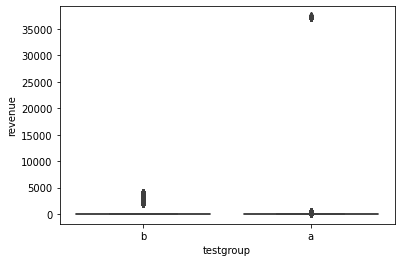

In [27]:
sns.boxplot(data=test_df, x='testgroup', y='revenue')
plt.show()
#i decided not to remove outliers because we are analyzing money data

In [28]:
a_group = test_df.query('testgroup == "a"')
b_group = test_df.query('testgroup == "b"')

In [29]:
a_group.revenue.std()

920.7681368333677

In [30]:
b_group.revenue.std()

287.32416166927845

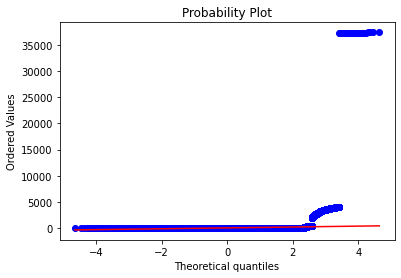

In [31]:
res = stats.probplot(test_df['revenue'], plot=plt)
plt.show()
#the points on the graph do not lie on a straight line, it indicates a non-normal distribution

In [37]:
stat, p = shapiro(test_df['revenue'])
print('Statistics=%.3f, p=%.3f' % (stat, p))
alpha = 0.05
if p > alpha:
    print('normal distribution (accept H0)')
else:
    print('non-normal distribution (reject H0)')
#we reject the null hypothesis that the distribution is normal

Statistics=0.015, p=0.000
non-normal distribution (reject H0)


/opt/tljh/user/lib/python3.7/site-packages/scipy/stats/morestats.py:1760: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


In [38]:
df_groups = test_df.groupby(['testgroup'], as_index=False).agg({'user_id' : 'count', 'revenue' : 'sum'})
df_groups
#calculate the revenue by groups

,testgroup,user_id,revenue
0,a,202103,5136189
1,b,202667,5421603


In [40]:
df_groups['arpu'] = df_groups['revenue'] / df_groups['user_id']
#calculate ARPU by groups

In [42]:
df_groups2=test_df.groupby(['testgroup'], as_index=False)['revenue'].apply(lambda x: (x > 0).sum())
df_groups2
#calculate the number of paying users by groups.

,testgroup,revenue
0,a,1928
1,b,1805


In [43]:
df_groups2=df_groups2.rename(columns={'revenue' : 'paying_users'})

In [44]:
df_groups=df_groups2.merge(df_groups, on ='testgroup', how='inner')

In [45]:
df_groups['paying_rate'] = df_groups['paying_users'] / df_groups['user_id']
df_groups['arppu'] = df_groups['revenue'] / df_groups['paying_users']
df_groups.head()
#Created a table with metrics to pay attention to (number of paying users, average revenue per user, average revenue per paying user, conversion rate to paying).
#Group A has a higher number of paying users, but lower ARPU and ARPPU
#Group B has a lower number of paying users, but higher ARPU and ARPPU

,testgroup,paying_users,user_id,revenue,arpu,paying_rate,arppu
0,a,1928,202103,5136189,25.413720,0.009540,2663.998444
1,b,1805,202667,5421603,26.751287,0.008906,3003.658172


The key metric is revenue, it depends on the conversion rate to paying user (paying_rate) and average revenue per user (ARPU). First, let's look at the average revenue per user.
- Null hypothesis: The set of promotional offers in group A does not significantly differ from the offers in group B in terms of their impact on ARPU.
- Alternative hypothesis: The set of promotional offers in group A significantly differs from the offers in group B in terms of their impact on ARPU.

The distribution is non-normal, but I will use the t-test for hypothesis testing (the article presented in the course mentions that using the Mann-Whitney criterion for a non-normal distribution in the process of evaluating the results of an A/B test is incorrect https://habr.com/ru/companies/avito/articles/709596/ + in other articles I have read that the normality assumption can be disregarded for large datasets).

In [46]:
ss.ttest_ind(a_group.revenue, b_group.revenue)

Ttest_indResult(statistic=-0.6242026493616787, pvalue=0.532494858971837)

The p-value is bigger than 0.05, so we accept the null hypothesis and conclude that the means in the groups do not differ significantly, it means that there is no statistically significant difference in ARPU between the groups

The second step is to look at the paying_rate, a metric similar to conversion rate, so i will use the chi-square test.

- Null hypothesis: The set of promotional offers in group A does not significantly differ from the offers in group B in terms of their impact on the conversion rate to paying user
- Alternative hypothesis: The set of promotional offers in group A significantly differs from the offers in group B in terms of their impact on the conversion rate to paying user

In [48]:
test_df['paying_user'] = test_df['revenue'].apply(lambda x: 1 if x > 0 else 0)
test_df
#transform the data so that we can create a contingency table: add a column where 1 = paying user, 0 = non-paying user.

,user_id,revenue,testgroup,paying_user
0,1,0,b,0
1,2,0,a,0
2,3,0,a,0
3,4,0,b,0
4,5,0,b,0
...,...,...,...,...
404765,404766,0,a,0
404766,404767,0,b,0
404767,404768,231,a,1
404768,404769,0,a,0


In [49]:
contingency_table = pd.crosstab(test_df['testgroup'], test_df['paying_user'])
contingency_table

paying_user,0,1
testgroup,,
a,200175,1928
b,200862,1805


In [50]:
chi2_stat, p_val, _, _ = chi2_contingency(contingency_table)

print("chi-square stat:", chi2_stat)
print("p-value:", p_val)

chi-square stat: 4.374729521260405
p-value: 0.03647561892312613


The p-value is below the 0.05 level, so we reject the null hypothesis and conclude that there are statistically significant differences between groups A and B.
The conversion rate to paying user (paying rate) is higher in group A, the promotional offers in this group are more effective in influencing the paying_rate

## Conclusion 
Based on the analysis of the A/B test results, we see that in group A, the paying rate is significantly higher (there is no statistically significant difference in ARPU). From the perspective of influencing revenue, group A is more effective, so we will keep the promotional offers presented in this group.